Aluno: João Guilherme Bezerra Alves

In [22]:
## Importing/Installing Libs
!git clone https://github.com/ultralytics/yolov5    #Cloning object detection arc
%cd yolov5
%pip install -qr requirements.txt     #Installing dependencies
%pip install -q roboflow

import torch    #To use cuda, and GPU
import os
from IPython.display import Image, clear_output    #To Display Images

!pip install joblib

!pip install roboflow    # Roboflow snippet
from roboflow import Roboflow

%pip install -q wandb    #Weights and biases
import wandb

import sys
from google.colab import drive
from google.colab import files

Cloning into 'yolov5'...
remote: Enumerating objects: 14469, done.
remote: Total 14469 (delta 0), reused 0 (delta 0), pack-reused 14469
Receiving objects: 100% (14469/14469), 13.47 MiB | 25.45 MiB/s, done.
Resolving deltas: 100% (9988/9988), done.
/content/yolov5/yolov5/yolov5
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sentry-sdk 1.10.1 requires urllib3>=1.26.11; python_version >= "3.6", but you have urllib3 1.26.6 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
roboflow 0.2.18 requires urllib3==1.26.6, but you hav

In [3]:
rf = Roboflow(api_key="ESwGU6duNgdRYU6YqqPd")
project = rf.workspace("kartplates").project("kart_plates")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to kart_plates-1 in yolov5pytorch:: 100%|██████████| 622/622 [00:00<00:00, 1096.51it/s]


In [4]:
def wandb_colab_login():
    '''Temporary hack to prevent colab from hanging'''
    sys.modules['google.colab2'] = sys.modules['google.colab']
    del sys.modules['google.colab']
    wandb.login()
    sys.modules['google.colab'] = sys.modules["google.colab2"]

wandb_colab_login()

ERROR:wandb.jupyter:Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 

··········


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [5]:
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [6]:
!python train.py --img 305 --batch 30 --epoch 4000 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

wandb: Currently logged in as: jgba. Use `wandb login --relogin` to force relogin
train: weights=yolov5s.pt, cfg=, data=/content/yolov5/yolov5/kart_plates-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=4000, batch_size=30, imgsz=305, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-225-g02b8a4c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05

In [28]:
%cp -r /content/yolov5/yolov5/runs/train '/content/gdrive/MyDrive/Colab Notebooks/6 - Modelos Preditivos Conexionistas/Trabalho/'

Evaluating Performance

In [8]:
#Start Tensorboard
#Launch after you have started training
#Logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [9]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/yolov5/yolov5/kart_plates-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-225-g02b8a4c Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
image 1/62 /content/yolov5/yolov5/kart_plates-1/test/images/00035_jpg.rf.e281418b119857e1948558c316f1d782.jpg: 416x416 1 40, 1 50, 8.0ms
image 2/62 /content/yolov5/yolov5/kart_plates-1/test/images/01173_jpg.rf.21580d73fc32390e02e88abc577c6bc5.jpg: 416x416 1 40, 1 50, 8.4ms
image 3/62 /content/yolov5/yolov5/kart_plate

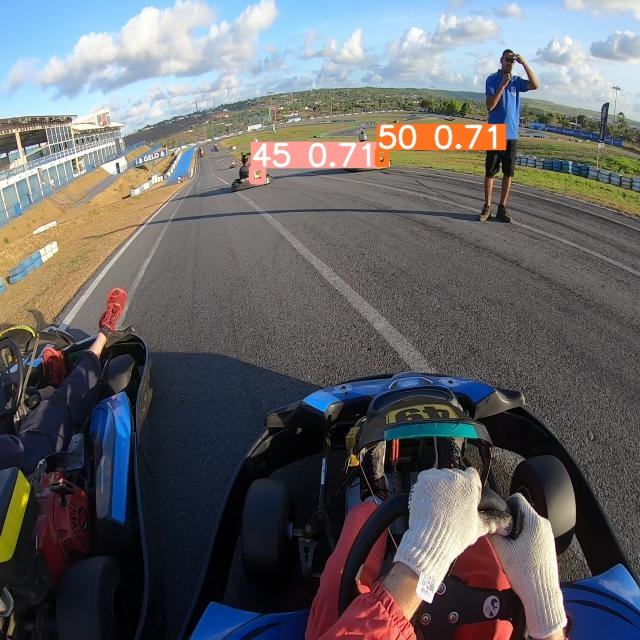

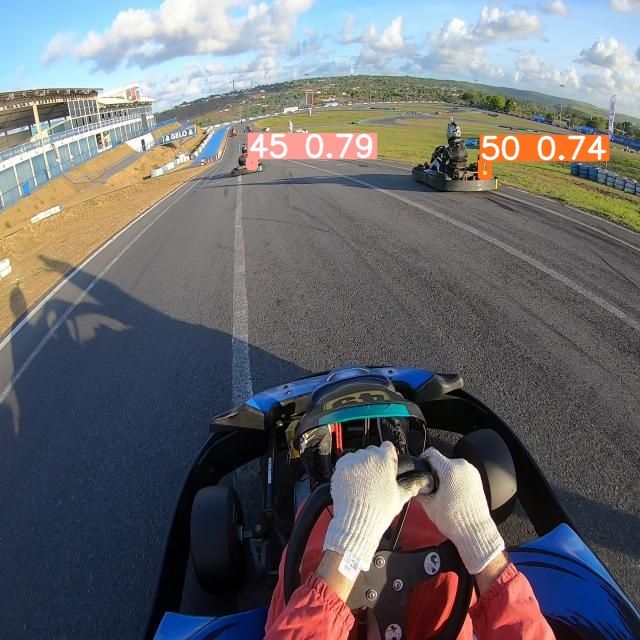

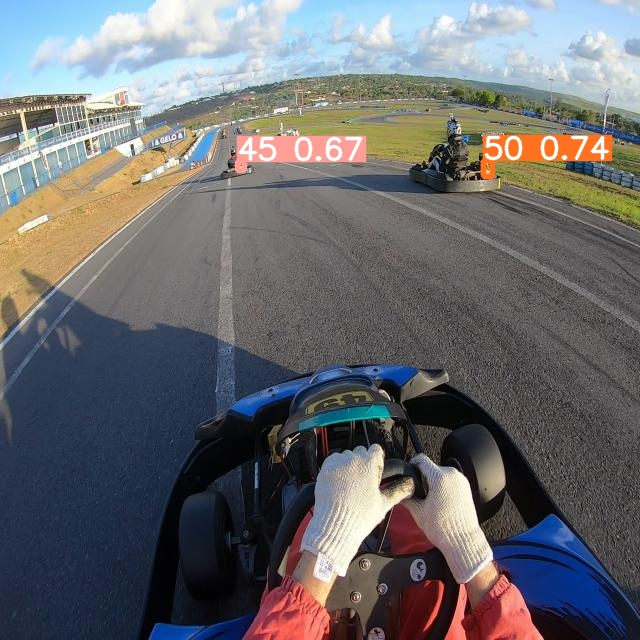

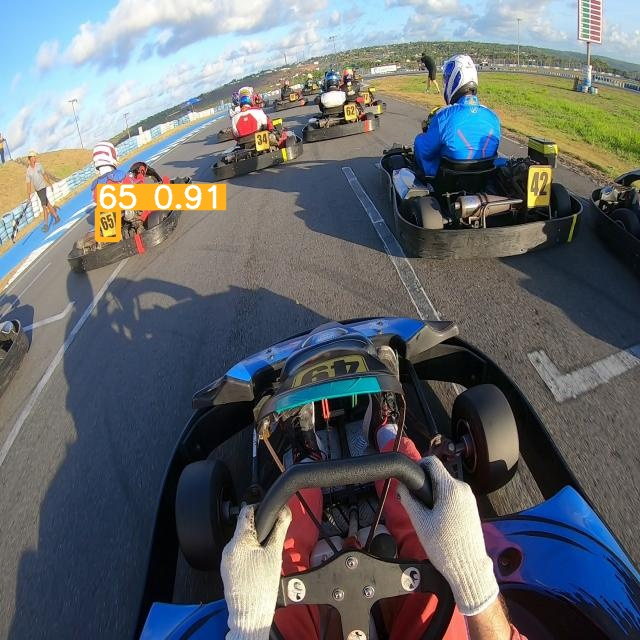

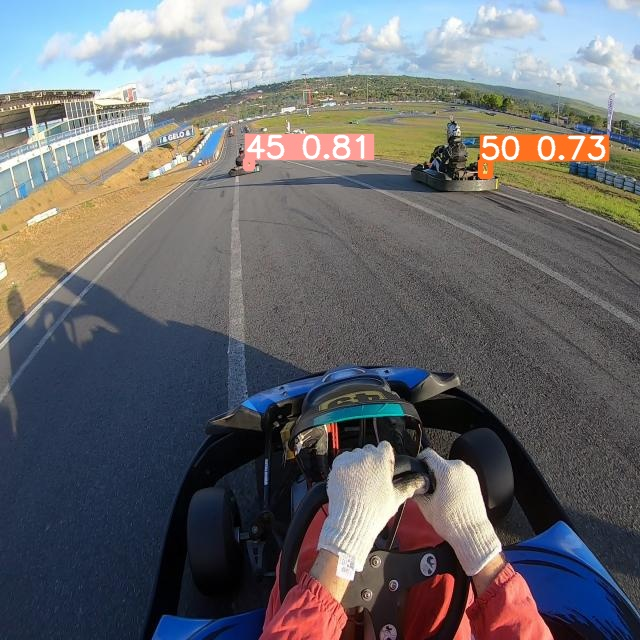

...

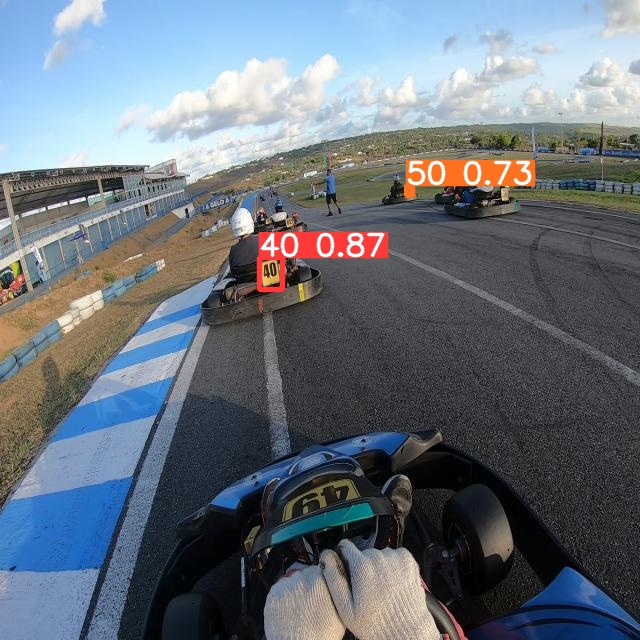

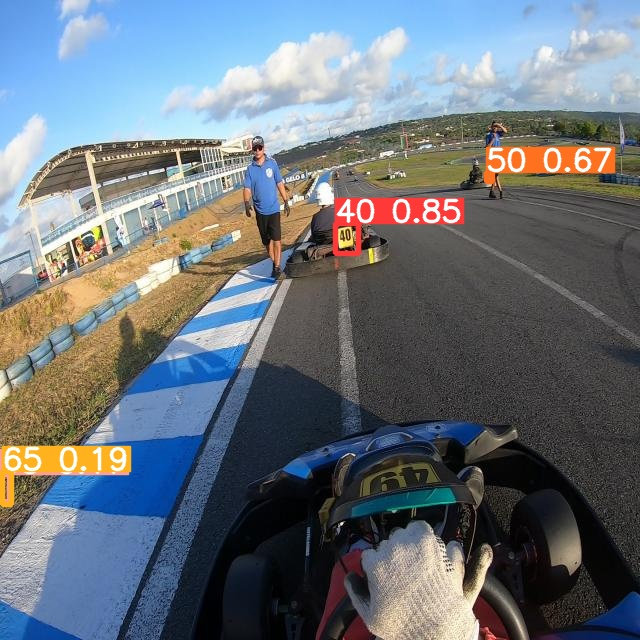

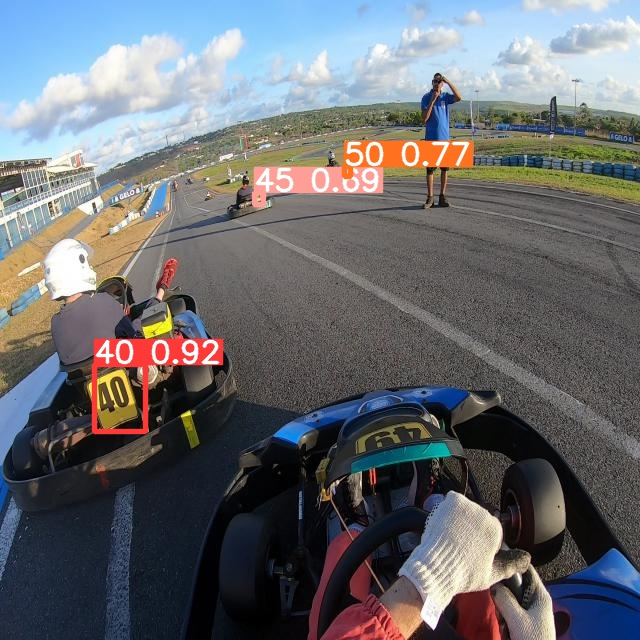

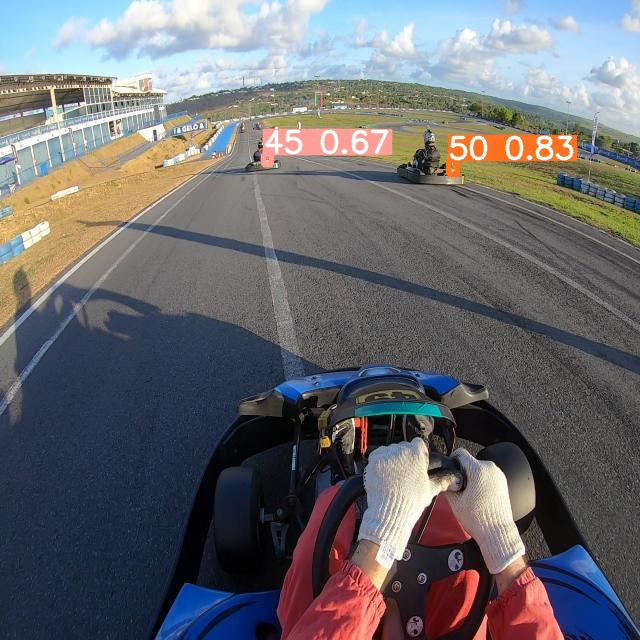

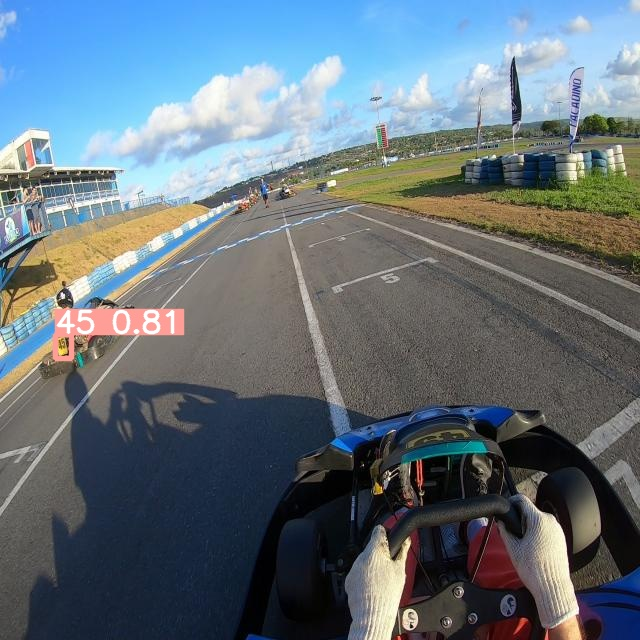

In [30]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

#Baixando o modelo

In [11]:
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>